<html>
<body>
<p style="font-size: 30px;text-align:center;color:blue;">Plotting Earth Science Data</p>
    <p style="font-size: 20px;text-align:center;color:blue;">Vol. II </p>
    <p style="font-size: 15px;text-align:center;color:black;">A guide to analyze and plot Earth Science data with focus in Oceanography, Meteorology, and Microwave Remote Sensing Science</p>
    <p style="font-size: 15px;text-align:center;color:black;">Prepared by: Michael Nguyen</p>

![](https://study.com/cimages/course-image/nes-earth-space-science-test-practice-study-guide_186154_large.jpg)    

###### Project Inspired by:
[Dr. Bryan Jones - CodeChat](https://codechat.readthedocs.io/en/master/)

[Dr. Mehmet Kurum](https://my.ece.msstate.edu/faculty/kurum/)

[Dr. Donald Knuth - Literature Programming](https://www-cs-faculty.stanford.edu/~knuth/lp.html)

###### Latest update as of: 04/09/2023        

<p style="font-size: 30px;text-align:center;color:black;">Table of Contents </p>

### 1.0 [Background](#section_background) 

### 2.0 [Problem Statement](#section_problemstatement) 

### 3.0 [Purpose](#section_purpose) 

### 4.0 [Installation Procedure](#section_installationprocedure)

#### 4.3.1 [Standard Library imports](#section_StandardLibraryimports) 

#### 4.3.2 [Libraries Related to netCDF files](#section_LibrariesRelatedtonetCDF)
    
#### 4.3.3 [Libraries Related to Mapping/Plotting](#section_LibrariesRelatedtoMapping/Plotting)
    
#### 4.3.4 [Libraries Related to Animation](#section_LibrariesRelatedtoAnimation)


## Purpose
The purpose of this program is to plot CYGNSS data products. The data products for CYGNSS was obtained from a public domain from the PODAAC server. Maps and plots generated are based on 24 hours UTC information.

* PODAAC: [Click here](https://podaac.jpl.nasa.gov/dataset/CYGNSS_L1_V3.1?ids=Projects&values=CYGNSS&provider=POCLOUD*)

* CYGNSS Handbook: [Click here](https://cygnss.engin.umich.edu/wp-content/uploads/sites/534/2021/06/CYGNSS_Handbook_April2016.pdf)

Other Useful References:
* Jyputer Markdown: [Click here](https://daringfireball.net/projects/markdown/syntax#list)
* Markdown Cheatsheet: [Click here](https://github.com/adam-p/markdown-here/wiki/Markdown-Cheatsheet)
* HTML tutorial: [Click here](https://www.w3schools.com/html/html_basic.asp)





## Imported Libraries ## 

#### Standard imports: ####
* [numpy](https://numpy.org/) - Purpose: Mathematic library used for the field of Science and Engineering.

#### Related to netCDF files: ####
* [netCDF4](https://unidata.github.io/netcdf4-python/) - Purpose:  Used to read/write netCDF files, Version 4 used to read and write HDF5 netCDF files.

* [xarray](https://docs.xarray.dev/en/stable/user-guide/io.html) - Purpose:  Used to store netCDF files format. 

#### Related to Mapping/Plotting: ####
* [cartopy](https://scitools.org.uk/cartopy/docs/latest/) - Purpose: Used for geospatial data processing in order to produce maps and other geospatial data analyses.
* [cartopy.gridliner](https://scitools.org.uk/cartopy/docs/latest/reference/generated/cartopy.mpl.gridliner.Gridliner.html) - Purpose: Used to specify lat/lon grids axis based on World Geodetic System [(WGS84)](https://gisgeography.com/wgs84-world-geodetic-system/) coordinate system. 
* [cartopy.feature](https://scitools.org.uk/cartopy/docs/latest/matplotlib/feature_interface.html) - Purpose: Used to easily add map features of land, ocean, etc.
* [Matplotlib](https://scitools.org.uk/cartopy/docs/latest/reference/matplotlib.html) - Purpose: Extends some matploblib capabilities to plot cartopy projections and transform points. matplotlib.rcParams is increased to ensure that animation does not drop frames. This increases the default size for an animation. Another useful [link](https://matplotlib.org/stable/index.html)

#### Related to Animation: ####
* [matplotlib.animation](https://matplotlib.org/stable/api/animation_api.html) - Purpose: Create live animation from plots
* [Matplotlib.FuncAnimation](https://matplotlib.org/stable/api/_as_gen/matplotlib.animation.FuncAnimation.html#matplotlib.animation.FuncAnimation) - Purpose: Makes the animation repeates/loops.
* [Ipython.display](https://ipython.readthedocs.io/en/stable/api/generated/IPython.display.html) - Purpose: Used to handel displaying plot, graphs, maps in Jyputer html format. 
* [matplotlib.markers](https://matplotlib.org/stable/api/markers_api.html) - Purpose: Used to designate specific markers to plot CGYNSS data products.
* [marker annotation](https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.annotate.html#matplotlib.pyplot.annotate) - Purpose: Used to annotate certain coordinates with specific texts

In [1]:
import numpy as np

from netCDF4 import Dataset
import xarray as xr

import cartopy.crs as ccrs
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import cartopy.feature as cfeature 
import matplotlib.pyplot as plt

import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

## Reading netCDF Data

1. Using netCFD4 Library Dataset function to read CYGNSS data and set it to a variable, data_*karg
2. Optional, but very useful: Using xarray netCDF Libaray function xr to open the data set and view it in html. 

*Note: xarray.xr makes it easy to quickly view the data format of a netCDL data type for development as demostrated below*

In this program, we will be using netCFD4 library to extract the data from the .nc file.

In [2]:
#Example L2 Plots
data = Dataset(r'cyg.ddmi.s20220920-000000-e20220920-235959.l2.wind-mss.a31.d32.nc')
#Animation Example
data0920 = Dataset(r'cyg.ddmi.s20220920-000000-e20220920-235959.l2.wind-mss.a31.d32.nc')
data0921 = Dataset(r'cyg.ddmi.s20220921-000000-e20220921-235959.l2.wind-mss.a31.d32.nc')
data0922 = Dataset(r'cyg.ddmi.s20220922-000000-e20220922-235959.l2.wind-mss.a31.d32.nc')
data0923 = Dataset(r'cyg.ddmi.s20220923-000000-e20220923-235959.l2.wind-mss.a31.d32.nc')
data0924 = Dataset(r'cyg.ddmi.s20220924-000000-e20220924-235959.l2.wind-mss.a31.d32.nc')
data0925 = Dataset(r'cyg.ddmi.s20220925-000000-e20220925-235959.l2.wind-mss.a31.d32.nc')
data0926 = Dataset(r'cyg.ddmi.s20220926-000000-e20220926-235959.l2.wind-mss.a31.d32.nc')
data0927 = Dataset(r'cyg.ddmi.s20220927-000000-e20220927-235959.l2.wind-mss.a31.d32.nc')
data0928 = Dataset(r'cyg.ddmi.s20220928-000000-e20220928-235959.l2.wind-mss.a31.d32.nc')
data0929 = Dataset(r'cyg.ddmi.s20220929-000000-e20220929-235959.l2.wind-mss.a31.d32.nc')
data0930 = Dataset(r'cyg.ddmi.s20220930-000000-e20220930-235959.l2.wind-mss.a31.d32.nc')

In [3]:
ds = xr.open_dataset('cyg.ddmi.s20220920-000000-e20220920-235959.l2.wind-mss.a21.d21.nc')
ds

<xarray.Dataset>
Dimensions:                                  (sample: 1386461, ddm: 5, averaged_l1: 4)
Coordinates:
  * sample                                   (sample) int32 0 1 ... 1386460
  * ddm                                      (ddm) int32 0 1 2 3 4
  * averaged_l1                              (averaged_l1) int32 -2147483647 ...
    sample_time                              (sample) datetime64[ns] ...
    lat                                      (sample) float32 ...
    lon                                      (sample) float32 ...
Data variables: (12/36)
    ddm_source                               float32 ...
    spacecraft_id                            (sample) float32 ...
    spacecraft_num                           (sample) float32 ...
    prn_code                                 (sample) float32 ...
    sv_num                                   (sample) float32 ...
    antenna                                  (sample) float32 ...
    ...                                       ...
    ddm_obs_utilized_flag                    (sample, ddm) float32 ...
    ddm_sample_index                         (sample, ddm, averaged_l1) float64 ...
    ddm_num_averaged_l1                      (sample, ddm) float32 ...
    ddm_channel                              (sample, ddm) float32 ...
    ddm_les                                  (sample, ddm) float32 ...
    ddm_nbrcs                                (sample, ddm) float32 ...
Attributes: (12/41)
    Conventions:                               CF-1.6, ACDD-1.3, ISO-8601
    standard_name_vocabulary:                  CF Standard Name Table v30
    project:                                   CYGNSS
    featureType:                               trajectory
    summary:                                   CYGNSS is a NASA Earth Venture...
    program:                                   CYGNSS
    ...                                        ...
    geospatial_lat_min:                        -42.628N
    geospatial_lat_max:                        42.690N
    geospatial_lon_min:                        0.000E
    geospatial_lon_max:                        360.000E
    platform:                                  Observatory References: cyg1, ...
    NCO:                                       4.4.4

In [4]:
#coordinate dataset
lat = data['lat']
lon = data['lon']
time = data['sample_time']
avg_l1 = data['averaged_l1']

#variable dataset
spacecraft_id = data.variables['spacecraft_num']
#Examples for L2 Plots
ws = data.variables['wind_speed']
ws_hi = data.variables['yslf_nbrcs_high_wind_speed']
#Examples for Animation L2 Plots
lat_0920 = data0920['lat']
lon_0920 = data0920['lon']
lat_0921 = data0921['lat']
lon_0921 = data0921['lon']
lat_0922 = data0922['lat']
lon_0922 = data0922['lon']
lat_0923 = data0923['lat']
lon_0923 = data0923['lon']
lat_0924 = data0924['lat']
lon_0924 = data0924['lon']
lat_0925 = data0925['lat']
lon_0925 = data0925['lon']
lat_0926 = data0926['lat']
lon_0926 = data0926['lon']
lat_0927 = data0927['lat']
lon_0927 = data0927['lon']
lat_0928 = data0928['lat']
lon_0928 = data0928['lon']
lat_0929 = data0929['lat']
lon_0929 = data0929['lon']
lat_0930 = data0930['lat']
lon_0930 = data0930['lon']
ws_hi_0920 = data0920.variables['yslf_nbrcs_high_wind_speed']
ws_hi_0921 = data0921.variables['yslf_nbrcs_high_wind_speed']
ws_hi_0922 = data0922.variables['yslf_nbrcs_high_wind_speed']
ws_hi_0923 = data0923.variables['yslf_nbrcs_high_wind_speed']
ws_hi_0924 = data0924.variables['yslf_nbrcs_high_wind_speed']
ws_hi_0925 = data0925.variables['yslf_nbrcs_high_wind_speed']
ws_hi_0926 = data0926.variables['yslf_nbrcs_high_wind_speed']
ws_hi_0927 = data0927.variables['yslf_nbrcs_high_wind_speed']
ws_hi_0928 = data0928.variables['yslf_nbrcs_high_wind_speed']
ws_hi_0929 = data0929.variables['yslf_nbrcs_high_wind_speed']
ws_hi_0930 = data0930.variables['yslf_nbrcs_high_wind_speed']

In [5]:
#Example L2 mph
ws_mph = ws[:]*2.236936
ws_hi_mph = ws_hi[:]*2.236936

#Example L2 Plots knots
ws_knots = ws[:]*1.94384
ws_hi_knots = ws_hi[:]*1.94384

#Example Animation
ws_hi_mph_0920 = ws_hi_0920[:]*2.236936
ws_hi_mph_0921 = ws_hi_0921[:]*2.236936
ws_hi_mph_0922 = ws_hi_0922[:]*2.236936
ws_hi_mph_0923 = ws_hi_0923[:]*2.236936
ws_hi_mph_0924 = ws_hi_0924[:]*2.236936
ws_hi_mph_0925 = ws_hi_0925[:]*2.236936
ws_hi_mph_0926 = ws_hi_0926[:]*2.236936
ws_hi_mph_0927 = ws_hi_0927[:]*2.236936
ws_hi_mph_0928 = ws_hi_0928[:]*2.236936
ws_hi_mph_0929 = ws_hi_0929[:]*2.236936
ws_hi_mph_0930 = ws_hi_0930[:]*2.236936



## Creating Global variables 
[Reference Link](https://manati.star.nesdis.noaa.gov/datasets/CYGNSSData.php)

C:\Users\Snow White\anaconda3\lib\site-packages\cartopy\mpl\gridliner.py:307: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
C:\Users\Snow White\anaconda3\lib\site-packages\cartopy\mpl\gridliner.py:343: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '


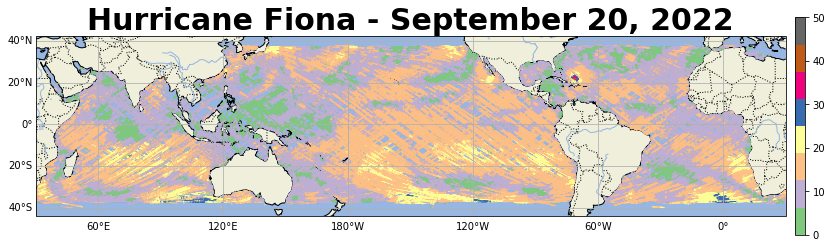

In [6]:
# Add Figure with Size of the Figure
fig = plt.figure(figsize=(16, 20))

# Add Map Projection
m = plt.axes(projection=ccrs.PlateCarree(-150))

# Add Map Features
m.add_feature(cfeature.LAND)
m.add_feature(cfeature.COASTLINE)
m.add_feature(cfeature.OCEAN)
m.add_feature(cfeature.BORDERS, linestyle=':')
m.add_feature(cfeature.LAKES, alpha=0.5)
m.add_feature(cfeature.RIVERS)

#Add Lat and Lon Labels
grid_lines = m.gridlines(draw_labels=True)
grid_lines.xlabels_top = False
grid_lines.ylabels_right = False
grid_lines.xformatter = LONGITUDE_FORMATTER
grid_lines.yformatter = LATITUDE_FORMATTER

#Add Title
m.set_title("Hurricane Fiona - September 20, 2022", fontsize = 30, color='black', fontweight='bold')

#Add Plot
plt.scatter(lon[:], lat[:], c=ws_knots[:], cmap=plt.cm.Accent, vmin=0, vmax=50, s=0.1, transform=ccrs.PlateCarree())

#Add Colorbar
cbar = plt.colorbar(orientation="vertical", shrink = 0.2, pad=0.01)

plt.show()

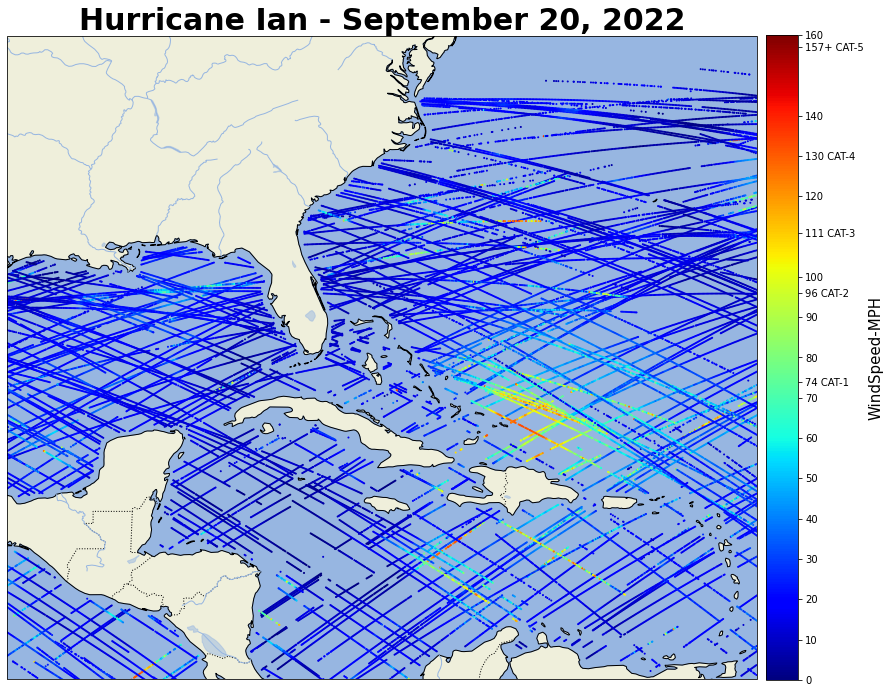

CAT-1: 75-95 mph
CAT-2: 96-110 mph
CAT-3: 111-129 mph
CAT-4: 130-156 mph
CAT-5: 157+ mph


In [7]:
# Add Figure with Size of the Figure
fig = plt.figure(figsize=(16, 20))

# Add Map Projection
m2 = plt.axes(projection=ccrs.PlateCarree())

# Add Map Features
m2.add_feature(cfeature.LAND)
m2.add_feature(cfeature.COASTLINE)
m2.add_feature(cfeature.OCEAN)
m2.add_feature(cfeature.BORDERS, linestyle=':')
m2.add_feature(cfeature.LAKES, alpha=0.5)
m2.add_feature(cfeature.RIVERS)

#Add Lat and Lon Labels
grid_lines = m.gridlines(draw_labels=True)
grid_lines.xlabels_top = False
grid_lines.ylabels_right = False
grid_lines.xformatter = LONGITUDE_FORMATTER
grid_lines.yformatter = LATITUDE_FORMATTER

#Set X and Y limits
#x0 by x1: 60W to 95W
m2.set_xlim(-95, -60)
#y0 by y1: 10N to 40N
m2.set_ylim(10, 40)

#Add Title
m2.set_title("Hurricane Ian - September 20, 2022", fontsize = 30, color='black', fontweight='bold')

#Add Plot
plt.scatter(lon[:], lat[:], c=ws_hi_mph[:], cmap=plt.cm.jet, vmin=0, vmax=160, s=1, transform=ccrs.PlateCarree())

#Add Colorbar
cbar = plt.colorbar(orientation="vertical", shrink = 0.593, pad=0.01)
cbar.set_label(label="WindSpeed-MPH", size = 15)
cbar.set_ticks([       0,   10,  20,   30,   40,   50,   60,   70,          74,   80,   90,         96,  100,          111,   120,         130,   140,           157,    160])
cbar.set_ticklabels(["0", "10", "20", "30", "40", "50", "60", "70", "74 CAT-1", "80", "90", "96 CAT-2", "100", "111 CAT-3", "120", "130 CAT-4",  "140", "157+ CAT-5",   "160"])

plt.show()

print("CAT-1: 75-95 mph")
print("CAT-2: 96-110 mph")
print("CAT-3: 111-129 mph")
print("CAT-4: 130-156 mph")
print("CAT-5: 157+ mph")

## Creating Global Function calls 
1. Converting seconds into readable formats
2. Setup function call handle for filenames and titles for each figure
3. Generate a function call to handle NOAA Hurrican Track for: 
    1. [Hurricane Fiona GND Track and Report](https://www.nhc.noaa.gov/archive/2022/FIONA.shtml)
    2. [Hurricane Ian GND Track and Report](https://www.nhc.noaa.gov/archive/2022/IAN.shtml)


In [8]:
#Setup Filename selection and Figure title
def fileselect(num):
    if (num == 0):
        fname0 = './Figure/Hurricane.Fiona.09.20.22.jpg'
        fname = fname0
    if (num == 1):
        fname1 = './Figure/Hurricane.Fiona.09.21.22.jpg'
        fname = fname1
    if (num == 2):
        fname2 = './Figure/Hurricane.Fiona.09.22.22.jpg'
        fname = fname2
    if (num == 3):
        fname3 = './Figure/Tropical.Storm.Ian.09.23.22.jpg'
        fname = fname3
    if (num == 4):
        fname4 = './Figure/Tropical.Storm.Ian.09.24.22.jpg'
        fname = fname4
    if (num == 5):
        fname5 = './Figure/Tropical.Storm.Ian.09.25.22.jpg'
        fname = fname5
    if (num == 6):
        fname6 = './Figure/Hurricane.Ian.09.26.22.jpg'
        fname = fname6
    if (num == 7):
        fname7 = './Figure/Hurricane.Ian.09.27.22.jpg'
        fname = fname7
    if (num == 8):
        fname8 = './Figure/Hurricane.Ian.09.28.22.jpg'
        fname = fname8
    if (num == 9):
        fname9 = './Figure/Tropical.Storm.Ian.09.29.22.jpg'
        fname = fname9
    if (num == 10):
        fname10 = './Figure/Tropical.Storm.Ian.09.30.22.jpg'
        fname = fname10
    return fname

def dailytrack(day):
    if (day == 20):
        #NOAA Reported at 2100ZU
        lat = -71.8 #71.8W
        lon = 22.0 #22.6N
        windspeed = 115 #115mph or 185 km/h
        Label = 'Fiona - Cat 3 115mph'
    if (day == 21):
        #NOAA Reported at 1500ZU
        lat = -71.7 #71.5W
        lon = 24.6 #25.6N
        windspeed = 130 #130mph or 215 km/h
        Label = 'Fiona - Cat 4 130mph'
    if (day == 22): 
        #NOAA Reported at 1500ZU
        lat = -69.5 #70.2W
        lon = 29.6 #29.6N
        windspeed = 130 #130mph or  215km/h
        Label = 'Fiona - Cat 4 130mph'
    if (day == 23): 
        #NOAA Reported at 2100ZU
        lat = -71.3 #71.3W
        lon = 14.7 #14.7N
        windspeed = 35 #35mph or  55km/h
        Label = 'Ian - Tropical Storm 35mph'
    if (day == 24): 
        #NOAA Reported at 2100ZU
        lat = -77.0 #77.0W
        lon = 14.3 #14.3N
        windspeed = 45 #45mph or  75km/h
        Label = 'Ian - Tropical Storm 45mph'
    if (day == 25): 
        #NOAA Reported at 2100ZU
        lat = -80.3 #80.3W
        lon = 16.2 #16.2N
        windspeed = 45 #45mph or  75km/h
        Label = 'Ian - Tropical Storm 45mph'
    if (day == 26): 
        #NOAA Reported at 2100ZU
        lat = -83.2 #80.3W
        lon = 20.3 #16.2N
        windspeed = 90 #90mph or  150km/h
        Label = 'Ian CAT-1 90mph'
    if (day == 27): 
        #NOAA Reported at 2100ZU
        lat = -83.2 #83.2W
        lon = 23.5 #23.5N
        windspeed = 115 #115mph or  185km/h
        Label = 'Ian CAT-3 115mph'
    if (day == 28): 
        #NOAA Reported at 2100ZU
        lat = -82.0 #82.0W
        lon = 26.9 #26.9N
        windspeed = 140 #140mph or  220km/h
        Label = 'Ian CAT-4 140mph'
    if (day == 29): 
        #NOAA Reported at 1500ZU
        lat = -80.4 #80.4W
        lon = 28.7 #28.7N
        windspeed = 70 #70mph or  110km/h
        Label = 'Ian Tropical Storm 70mph'
    if (day == 30): 
        #NOAA Reported at 2100ZU
        lat = -79.2 #79.2W
        lon = 33.9 #33.9N
        windspeed = 70 #70mph or  110km/h
        Label = 'Ian Tropical Storm 70mph'
    return lat, lon, windspeed, Label

def select_L2_plot(i):
    if i == 0:
        plt.scatter(lon_0920[:], lat_0920[:], c=ws_hi_mph_0920[:], cmap=plt.cm.jet, vmin=0, vmax=160, s=2, transform=ccrs.PlateCarree())
    if i == 1:
        plt.scatter(lon_0921[:], lat_0921[:], c=ws_hi_mph_0921[:], cmap=plt.cm.jet, vmin=0, vmax=160, s=2, transform=ccrs.PlateCarree())
    if i == 2:
        plt.scatter(lon_0922[:], lat_0922[:], c=ws_hi_mph_0922[:], cmap=plt.cm.jet, vmin=0, vmax=160, s=2, transform=ccrs.PlateCarree())
    if i == 3:
        plt.scatter(lon_0923[:], lat_0923[:], c=ws_hi_mph_0923[:], cmap=plt.cm.jet, vmin=0, vmax=160, s=2, transform=ccrs.PlateCarree())
    if i == 4:
        plt.scatter(lon_0924[:], lat_0924[:], c=ws_hi_mph_0924[:], cmap=plt.cm.jet, vmin=0, vmax=160, s=2, transform=ccrs.PlateCarree())
    if i == 5:
        plt.scatter(lon_0925[:], lat_0925[:], c=ws_hi_mph_0925[:], cmap=plt.cm.jet, vmin=0, vmax=160, s=2, transform=ccrs.PlateCarree())
    if i == 6:
        plt.scatter(lon_0926[:], lat_0926[:], c=ws_hi_mph_0926[:], cmap=plt.cm.jet, vmin=0, vmax=160, s=2, transform=ccrs.PlateCarree())
    if i == 7:
        plt.scatter(lon_0927[:], lat_0927[:], c=ws_hi_mph_0927[:], cmap=plt.cm.jet, vmin=0, vmax=160, s=2, transform=ccrs.PlateCarree())
    if i == 8:
        plt.scatter(lon_0928[:], lat_0928[:], c=ws_hi_mph_0928[:], cmap=plt.cm.jet, vmin=0, vmax=160, s=2, transform=ccrs.PlateCarree())
    if i == 9:
        plt.scatter(lon_0929[:], lat_0929[:], c=ws_hi_mph_0929[:], cmap=plt.cm.jet, vmin=0, vmax=160, s=2, transform=ccrs.PlateCarree())
    if i == 10:
        plt.scatter(lon_0930[:], lat_0930[:], c=ws_hi_mph_0930[:], cmap=plt.cm.jet, vmin=0, vmax=160, s=2, transform=ccrs.PlateCarree())


## Example - Generating a Map with Image Over lay, MODIS ##

NASA Worldview is an open to the public source providing snapshots of NASA satellite imagery layer. In this example, we will obtain a screen shots from MODIS mission imagery and overlay it over the map. The imagery is geospatically accurate image of Hurricane Ian making landfall on Sep 28 2022. The imagery specific boundary and details are below.

Regional boundary:
1. Bottom Left, Lat: 14 Lon:-92
2. Top Right, Lat: 36 Lon:-62
3. Resolution 1km, JPEG + World File
4. Hyperlink: [Click here](https://wvs.earthdata.nasa.gov/?LAYERS=VIIRS_NOAA20_CorrectedReflectance_TrueColor,Coastlines_15m,Reference_Features_15m&CRS=EPSG:4326&TIME=2022-09-20&COORDINATES=14,-92,36,-62&FORMAT=image/jpeg&WORLDFILE=true&AUTOSCALE=TRUE&RESOLUTION=1km)

*Note:The filename must and spatical boundaries must be set before the image can be plot. The user must go to the website above and determine the bounding box. Once the bounding box is determined, the file image can be loaded in this cartopy.*

1. Locate the file name and key in the directory.

2. The User is to key in the the bounding box lat/lon. The software below will convert the values to the correct argues ready for cartopy. 

3. Create a figure using a specific dimensions in inches 

4. Generate a map projection then set the plot to a variable[<sup>1</sup>](#fn1)  [<sup>2</sup>](#fn2)

5. Add features to the map. [<sup>3</sup>](#fn3)  

6. Add Latitude and Longitude coordinate labels using the cartopy.grider library 

7. Convert NASA boundingbox specifics into useful argues for cartopy. Make ready the image for plotting using the im_extend function.

8. Add title to the plot

9. Plot the image starting at the orgin (Top Right Cornern), then execute the plot by plt.show()

10. Optional: The plots (bottom-left, and upper-right) are present to show the accuracy of cartopy and NASA MODIS imagery.

#### Foot Note ###
<span id="fn1">1</span>: The line plt.axes(projection=ccrs.PlateCarree()) sets up a GeoAxes instance which exposes a variety of other projections. [click here](https://scitools.org.uk/cartopy/docs/v0.15/crs/projections.html) for a list of projection. 

<span id="fn1">2</span>: The core concept is that the projection of your axes is independent of the coordinate system your data is defined in. The **projection argument** is used when creating plots and determines the projection of the resulting plot (i.e. what the plot looks like). The **transform** argument to plotting functions tells Cartopy what coordinate system your data are defined in.   

<span id="fn1">3</span>: Notice that we are not using stock_image. Using stock_image will remove the NASA image overlay.

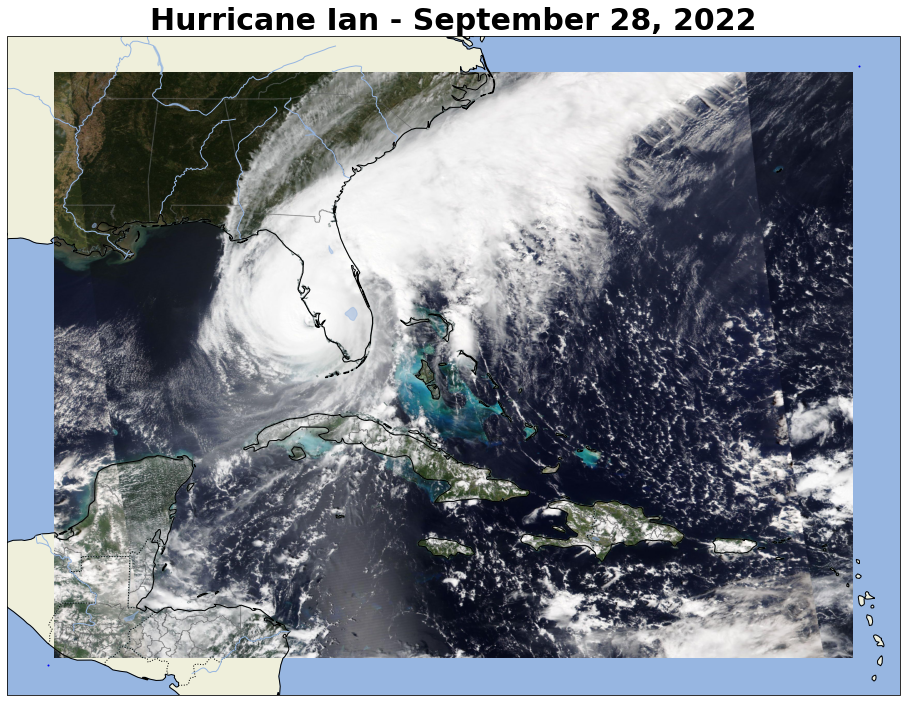

In [9]:
## Setup Image Boundaries
fname = './Figure/Hurricane.Ian.09.28.22.jpg'

#Bounding Box, BL = Bottom Left, TR = Top Right
lat_BL = 14
lon_BL = -92
lat_TR = 36
lon_TR = -62

# Add Figure with Size of the Figure
fig = plt.figure(figsize=(16, 20))

# Add Map Projection
m3 = plt.axes(projection=ccrs.PlateCarree())

# Add Map Features
m3.add_feature(cfeature.LAND)
m3.add_feature(cfeature.COASTLINE)
m3.add_feature(cfeature.OCEAN)
m3.add_feature(cfeature.BORDERS, linestyle=':')
m3.add_feature(cfeature.LAKES, alpha=0.5)
m3.add_feature(cfeature.RIVERS)
#m.stock_img()

#Add Lat and Lon Labels
grid_lines = m.gridlines(draw_labels=True)
grid_lines.xformatter = LONGITUDE_FORMATTER
grid_lines.yformatter = LATITUDE_FORMATTER

#Convert coordinates ready for img_ext function 
x0 = lon_BL
y0 = lat_BL
x1 = lon_TR
y1 = lat_TR

#Extend the image according to lat/lon coordinates
img_extent = (x0, x1, y0, y1)

#plot image
img = plt.imread(fname)
m3.imshow(img, origin='upper', extent=img_extent, transform=ccrs.PlateCarree())

#Add Title
m3.set_title("Hurricane Ian - September 28, 2022", fontsize = 30, color='black', fontweight='bold')

#Optional: Plot 4 corners boundary to demostrate map accuracy with overlay
Off_set = 0.25
#Top Right corner
m3.plot(-62+Off_set, 36+Off_set, 'bo', markersize=1, transform=ccrs.Geodetic())
#Bottom left corner
m3.plot(-92-Off_set, 14-Off_set, 'bo', markersize=1, transform=ccrs.Geodetic())

plt.show()

## Example - Generating an animated map with Image Over lay, MODIS ##

[NOAA](https://www.nesdis.noaa.gov/news/hurricane-ians-path-of-destruction) reported the following timeline for Hurricane Ian:

1. 23Sep2022: NOAA Satellites watched Ian initially form as a tropical storm in the central Caribbean.
2. 26Sep2022: The named hurricane made landfall in western Cuba as a Cat 3* 
3. 28Sep2022: Hurricane Ian came ashore near Cayo Costa, FL as a Cat 4 with max sustained winds of 150mph*
    1. [Hurricane Fiona GND Track and Report](https://www.nhc.noaa.gov/archive/2022/FIONA.shtml)
    2. [Hurricane Ian GND Track and Report](https://www.nhc.noaa.gov/archive/2022/IAN.shtml)

Detailed report from NOAA Weather Center:
1. 20Sep2022: CAT 3 Hurricane Fiona Advisory with maximum sustained winds near 115 MPH 
2. 21Sep2022: CAT 4 Hurricane Fiona Advisory with maximum sustained winds near 130 MPH
3. 22Sep2022: CAT 4 Hurricane Fiona Advisory with maximum sustained winds near 130 MPH 
4. 23Sep2022: Watch Advisory for Tropical Storm Ian in the central Caribbean, 35 MPH
5. 24Sep2022: Watch Advisory for Tropical Storm Ian 45 MPH
5. 25Sep2022: Watch Advisory for Tropical Storm Ian 45 MPH
5. 26Sep2022: CAT 1 Hurricane Ian Advisory with maximum sustained winds near 90 MPH 
6. 27Sep2022: CAT 3 Hurricane Ian Advisory with maximum sustained winds near 115 MPH 
7. 28Sep2022: CAT 4 Hurricane Ian Advisory with maximum sustained winds near 140 MPH 
8. 29Sep2022: Watch Advisory for Tropical Storm Ian with maximum sustained winds near 70 MPH 
9. 30Sep2022: Watch Advisory for Tropical Storm Ian with maximum sustained winds near 70 MPH 


*Note:The animation below overlays NASA MODIS imagery of Hurricane Fiona and Hurricane Ian. The animation date ranges from 20-30 Sep 2022*


MovieWriter imagemagick unavailable; using Pillow instead.
C:\Users\Snow White\anaconda3\lib\site-packages\cartopy\mpl\gridliner.py:307: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
C:\Users\Snow White\anaconda3\lib\site-packages\cartopy\mpl\gridliner.py:343: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
C:\Users\Snow White\anaconda3\lib\site-packages\cartopy\mpl\gridliner.py:741: UserWarning: The labels of this gridliner do not belong to the gridliner axes
  warnings.warn('The labels of this gridliner do not belong to '
C:\Users\Snow White\anaconda3\lib\site-packages\cartopy\mpl\gridliner.py:307: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The

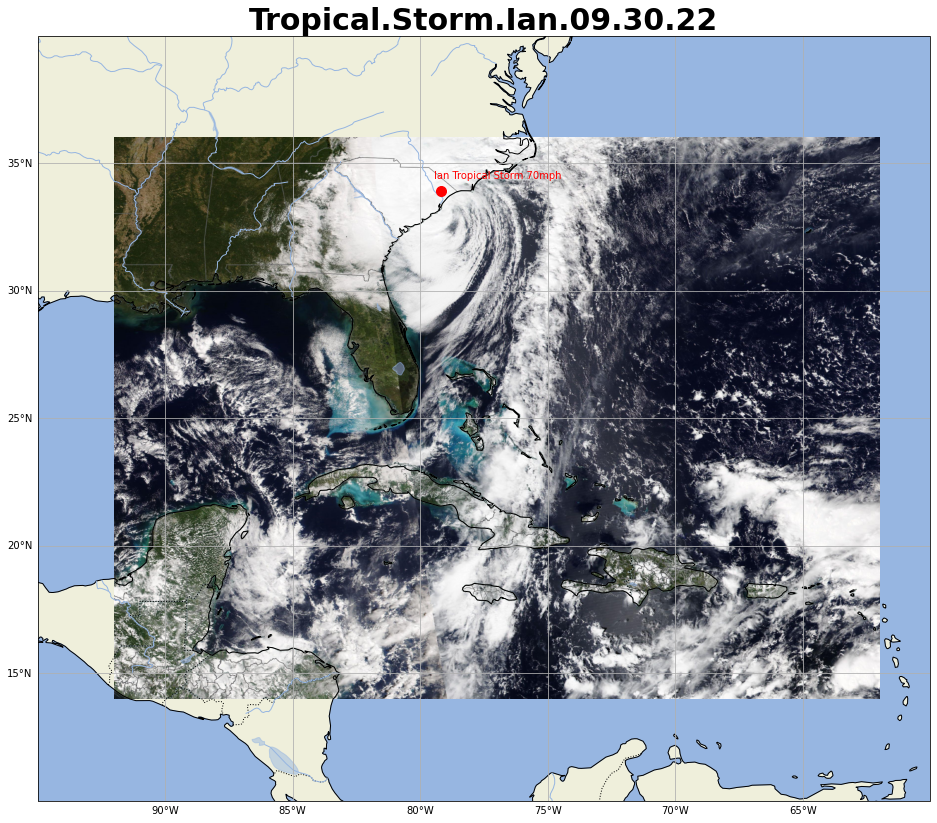

In [10]:
# Setup Image Boundaries
fname = './Figure/Hurricane.Ian.09.28.22.jpg'

#Bounding Box, BL = Bottom Left, TR = Top Right
lat_BL = 14
lon_BL = -92
lat_TR = 36
lon_TR = -62

# Add Figure with Size of the Figure
fig = plt.figure(figsize=(16, 20))

# Add Map Projection
m4 = plt.axes(projection=ccrs.PlateCarree())

# Add Map Features
m4.add_feature(cfeature.LAND)
m4.add_feature(cfeature.COASTLINE)
m4.add_feature(cfeature.OCEAN)
m4.add_feature(cfeature.BORDERS, linestyle=':')
m4.add_feature(cfeature.LAKES, alpha=0.5)
m4.add_feature(cfeature.RIVERS)

#Add Lat and Lon Labels
grid_lines = m4.gridlines(draw_labels=True)
grid_lines.xlabels_top = False
grid_lines.ylabels_right = False
grid_lines.xformatter = LONGITUDE_FORMATTER
grid_lines.yformatter = LATITUDE_FORMATTER

#Convert coordinates ready for img_ext function 
x0 = lon_BL
y0 = lat_BL
x1 = lon_TR
y1 = lat_TR

#Extend the image according to lat/lon coordinates
img_extent = (x0, x1, y0, y1)

#plot image
img = plt.imread(fname)
m4.imshow(img, origin='upper', extent=img_extent, transform=ccrs.PlateCarree())

#Add Title
m4.set_title("Hurricane Ian - September 28, 2022", fontsize = 30, color='black', fontweight='bold')

#Animatation function
def animate_image(i):
    
    #Clear Map Feature each interation
    m4.cla()
    
    # Add Map Features
    m4.add_feature(cfeature.LAND)
    m4.add_feature(cfeature.COASTLINE)
    m4.add_feature(cfeature.OCEAN)
    m4.add_feature(cfeature.BORDERS, linestyle=':')
    m4.add_feature(cfeature.LAKES, alpha=0.5)
    m4.add_feature(cfeature.RIVERS)
            
    #Add Lat and Lon Labels
    grid_lines = m4.gridlines(draw_labels=True)
    grid_lines.xlabels_top = False
    grid_lines.ylabels_right = False
    grid_lines.xformatter = LONGITUDE_FORMATTER
    grid_lines.yformatter = LATITUDE_FORMATTER
    
    #Set X and Y limits
    #x0 by x1: 60W to 95W
    m4.set_xlim(-95, -60)
    #y0 by y1: 10N to 40N
    m4.set_ylim(10, 40)
    
    #Animate title
    fname_temp = fileselect(i)
    fname_len = len(fname_temp)
    m4.set_title(fname_temp[9:(fname_len-4)], fontsize = 30, color='black', fontweight='bold')
    
    #Setup imagery
    img = plt.imread(fname_temp)
    m4.imshow(img, origin='upper', extent=img_extent, transform=ccrs.PlateCarree())
        
    #Setup Hurricane Tracks
    lat, lon, windspeed, storm_label = dailytrack(i+20)
    #Plot Hurricane Tracks  
    m4.plot(lat, lon, 'ro', markersize=10, transform=ccrs.Geodetic())
    m4.annotate(text=storm_label,xy=(lat, lon), color = 'red', xytext=(lat-0.25,lon+0.5))
    
anim = FuncAnimation(fig, animate_image, frames=11, interval=200*10^3)

#Save Animation
anim.save('Hurricane.gif', writer='imagemagick')

#plt.show()

HTML(anim.to_jshtml())

### Due to the simulation time, an animation of Hurricane Ian 1 day interval: ###

![Hurricane Ian](Hurricane_Day_Intevral.gif)

## Example - Map with Image Over lay, MODIS and CYGNSS L2 Plots ##

[NOAA](https://www.nesdis.noaa.gov/news/hurricane-ians-path-of-destruction) reported the following timeline for Hurricane Ian:

On 20Sep2022, CAT 3 Hurricane Fiona Advisory with maximum sustained winds near 115 MPH near the Carribean Island.

NOAA Weather Advisory Reports:
    1. [Hurricane Fiona GND Track and Report](https://www.nhc.noaa.gov/archive/2022/FIONA.shtml)
    

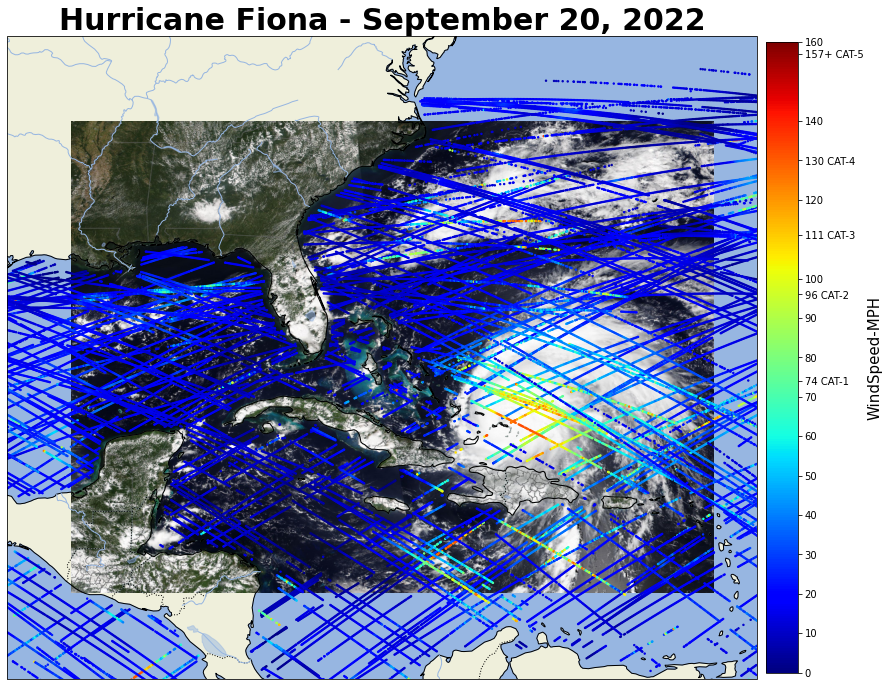

In [11]:
## Setup Image Boundaries
fname = './Figure/Hurricane.Fiona.09.20.22.jpg'

#Bounding Box, BL = Bottom Left, TR = Top Right
lat_BL = 14
lon_BL = -92
lat_TR = 36
lon_TR = -62

# Add Figure with Size of the Figure
fig = plt.figure(figsize=(16,20))

# Add Map Projection
m5 = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

# Add Map Features
m5.add_feature(cfeature.LAND)
m5.add_feature(cfeature.COASTLINE)
m5.add_feature(cfeature.OCEAN)
m5.add_feature(cfeature.BORDERS, linestyle=':')
m5.add_feature(cfeature.LAKES, alpha=0.5)
m5.add_feature(cfeature.RIVERS)

#Add Lat and Lon Labels
grid_lines = m.gridlines(draw_labels=True)
grid_lines.xlabels_top = False
grid_lines.ylabels_right = False
grid_lines.xformatter = LONGITUDE_FORMATTER
grid_lines.yformatter = LATITUDE_FORMATTER

#Set X and Y limits
#x0 by x1: 60W to 95W
m5.set_xlim(-95, -60)
#y0 by y1: 10N to 40N
m5.set_ylim(10, 40)

#Convert coordinates ready for img_ext function 
x0 = lon_BL
y0 = lat_BL
x1 = lon_TR
y1 = lat_TR

#Extend the image according to lat/lon coordinates
img_extent = (x0, x1, y0, y1)

#plot image
img = plt.imread(fname)
m5.imshow(img, origin='upper', extent=img_extent, transform=ccrs.PlateCarree())

#Add Title
m5.set_title("Hurricane Fiona - September 20, 2022", fontsize = 30, color='black', fontweight='bold')

#Add Plot
plt.scatter(lon[:], lat[:], c=ws_hi_mph[:], cmap=plt.cm.jet, vmin=0, vmax=160, s=2, transform=ccrs.PlateCarree())

#Add Colorbar
cbar = plt.colorbar(orientation="vertical", shrink = 0.58, pad=0.01)
cbar.set_label(label="WindSpeed-MPH", size = 15)
cbar.set_ticks([       0,   10,  20,   30,   40,   50,   60,   70,          74,   80,   90,         96,  100,          111,   120,         130,   140,           157,    160])
cbar.set_ticklabels(["0", "10", "20", "30", "40", "50", "60", "70", "74 CAT-1", "80", "90", "96 CAT-2", "100", "111 CAT-3", "120", "130 CAT-4",  "140", "157+ CAT-5",   "160"])
plt.show()

## Example - Generating an animated map with Image Over lay, MODIS and CYGNSS L2 Plots ##

[NOAA](https://www.nesdis.noaa.gov/news/hurricane-ians-path-of-destruction) reported the following timeline for Hurricane Ian:

1. 20Sep2022: CAT 3 Hurricane Fiona Advisory with maximum sustained winds near 115 MPH 
2. 21Sep2022: CAT 4 Hurricane Fiona Advisory with maximum sustained winds near 130 MPH
3. 22Sep2022: CAT 4 Hurricane Fiona Advisory with maximum sustained winds near 130 MPH 
4. 23Sep2022: Watch Advisory for Tropical Storm Ian in the central Caribbean, 35 MPH
5. 24Sep2022: Watch Advisory for Tropical Storm Ian 45 MPH
5. 25Sep2022: Watch Advisory for Tropical Storm Ian 45 MPH
5. 26Sep2022: CAT 1 Hurricane Ian Advisory with maximum sustained winds near 90 MPH 
6. 27Sep2022: CAT 3 Hurricane Ian Advisory with maximum sustained winds near 115 MPH 
7. 28Sep2022: CAT 4 Hurricane Ian Advisory with maximum sustained winds near 140 MPH 
8. 29Sep2022: Watch Advisory for Tropical Storm Ian with maximum sustained winds near 70 MPH 
9. 30Sep2022: Watch Advisory for Tropical Storm Ian with maximum sustained winds near 70 MPH 

NOAA Weather Advisory Reports:
    1. [Hurricane Fiona GND Track and Report](https://www.nhc.noaa.gov/archive/2022/FIONA.shtml)
    2. [Hurricane Ian GND Track and Report](https://www.nhc.noaa.gov/archive/2022/IAN.shtml)

MovieWriter imagemagick unavailable; using Pillow instead.
C:\Users\Snow White\anaconda3\lib\site-packages\cartopy\mpl\gridliner.py:307: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
C:\Users\Snow White\anaconda3\lib\site-packages\cartopy\mpl\gridliner.py:343: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
C:\Users\Snow White\anaconda3\lib\site-packages\cartopy\mpl\gridliner.py:741: UserWarning: The labels of this gridliner do not belong to the gridliner axes
  warnings.warn('The labels of this gridliner do not belong to '
C:\Users\Snow White\anaconda3\lib\site-packages\cartopy\mpl\gridliner.py:307: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The

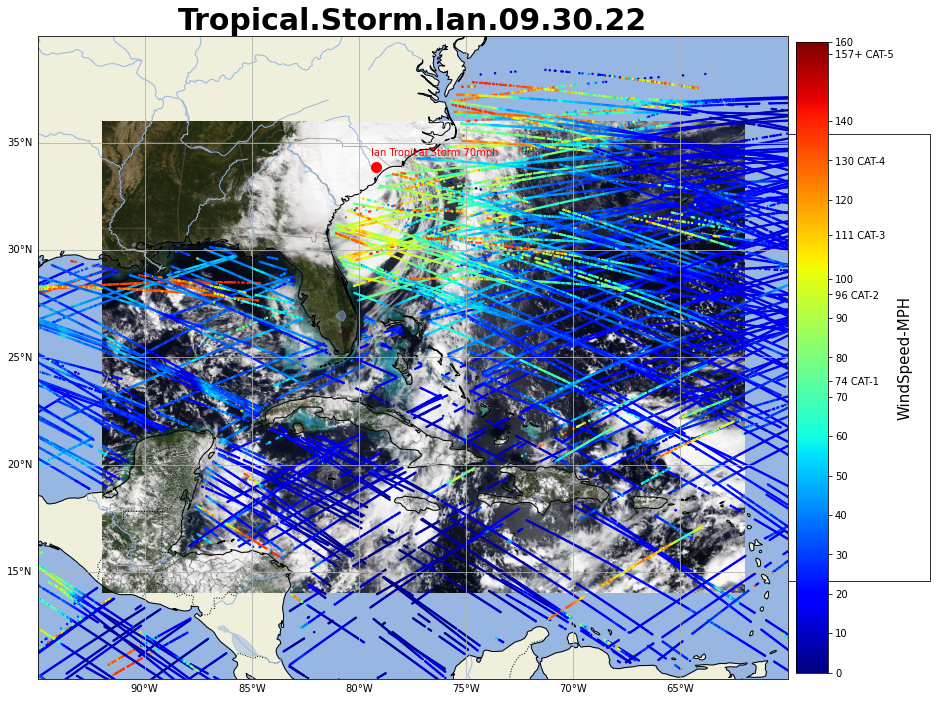

In [12]:
# Setup Image Boundaries
fname = './Figure/Hurricane.Fiona.09.20.22.jpg'

#Bounding Box, BL = Bottom Left, TR = Top Right
lat_BL = 14
lon_BL = -92
lat_TR = 36
lon_TR = -62

# Add Figure with Size of the Figure
fig = plt.figure(figsize=(16,20))

# Add Map Projection
m6 = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

# Add Map Projection
m6 = plt.axes(projection=ccrs.PlateCarree())

# Add Map Features
m6.add_feature(cfeature.LAND)
m6.add_feature(cfeature.COASTLINE)
m6.add_feature(cfeature.OCEAN)
m6.add_feature(cfeature.BORDERS, linestyle=':')
m6.add_feature(cfeature.LAKES, alpha=0.5)
m6.add_feature(cfeature.RIVERS)

#Add Lat and Lon Labels
grid_lines = m6.gridlines(draw_labels=True)
grid_lines.xlabels_top = False
grid_lines.ylabels_right = False
grid_lines.xformatter = LONGITUDE_FORMATTER
grid_lines.yformatter = LATITUDE_FORMATTER

#Convert coordinates ready for img_ext function 
x0 = lon_BL
y0 = lat_BL
x1 = lon_TR
y1 = lat_TR

#Extend the image according to lat/lon coordinates
img_extent = (x0, x1, y0, y1)

#plot image
img = plt.imread(fname)
m6.imshow(img, origin='upper', extent=img_extent, transform=ccrs.PlateCarree())

#Add Title
m6.set_title("Hurricane Fiona - September 20, 2022", fontsize = 30, color='black', fontweight='bold')
    
#Add Plot
plt.scatter(lon_0920[:], lat_0920[:], c=ws_hi_0920[:], cmap=plt.cm.jet, vmin=0, vmax=160, s=2, transform=ccrs.PlateCarree())

#Add Colorbar
cbar = plt.colorbar(orientation="vertical", shrink = 0.58, pad=0.01)
cbar.set_label(label="WindSpeed-MPH", size = 15)
cbar.set_ticks([       0,   10,  20,   30,   40,   50,   60,   70,          74,   80,   90,         96,  100,          111,   120,         130,   140,           157,    160])
cbar.set_ticklabels(["0", "10", "20", "30", "40", "50", "60", "70", "74 CAT-1", "80", "90", "96 CAT-2", "100", "111 CAT-3", "120", "130 CAT-4",  "140", "157+ CAT-5",   "160"])
    
#Animatation function
def animate_image(i):
    #Clear Map Feature each interation
    plt.cla()
    m6.cla()    
    
    #Plot L2 
    select_L2_plot(i)
        
    # Add Map Features
    m6.add_feature(cfeature.LAND)
    m6.add_feature(cfeature.COASTLINE)
    m6.add_feature(cfeature.OCEAN)
    m6.add_feature(cfeature.BORDERS, linestyle=':')
    m6.add_feature(cfeature.LAKES, alpha=0.5)
    m6.add_feature(cfeature.RIVERS)
            
    #Add Lat and Lon Labels
    grid_lines = m6.gridlines(draw_labels=True)
    grid_lines.xlabels_top = False
    grid_lines.ylabels_right = False
    grid_lines.xformatter = LONGITUDE_FORMATTER
    grid_lines.yformatter = LATITUDE_FORMATTER
    
    #Set X and Y limits
    #x0 by x1: 60W to 95W
    m6.set_xlim(-95, -60)
    #y0 by y1: 10N to 40N
    m6.set_ylim(10, 40)
    
    #Animate title
    fname_temp = fileselect(i)
    fname_len = len(fname_temp)
    m6.set_title(fname_temp[9:(fname_len-4)], fontsize = 30, color='black', fontweight='bold')
    
    #Setup imagery
    img = plt.imread(fname_temp)
    m6.imshow(img, origin='upper', extent=img_extent, transform=ccrs.PlateCarree())
        
    #Setup Hurricane Tracks
    lat, lon, windspeed, storm_label = dailytrack(i+20)
    #Plot Hurricane Tracks  
    m6.plot(lat, lon, 'ro', markersize=10, transform=ccrs.Geodetic())
    m6.annotate(text=storm_label,xy=(lat, lon), color = 'red', xytext=(lat-0.25,lon+0.5))
        
anim = FuncAnimation(fig, animate_image, frames=11, interval=200*10^3)

#Save Animation
anim.save('Hurricane2.gif', writer='imagemagick')

#plt.show()

HTML(anim.to_jshtml())




### Due to the simulation time, an animation for L2 Data Product with MODIS Overlay: ###

![Hurricane Ian](Hurricane_with_L2.gif)